
<a name='toc'></a>  TOC

* <a href='#me.01.t1'> Modeling and Evaluation 1</a> :
            Train and adjust parameters  
            
  - <a href='#spectral'>SpectralClustering</a>
  - <a href='#end_of_file'> end of file</a>


In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy

from pylab import rcParams
#import hdbscan

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

#### Read in cleaned  dataset from .csv file  

In [67]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in cleaned data set
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_03.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... add 'popular' binary based 'shares' values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_cluster['shares'] = np.exp(df_cluster['ln_shares'])

df_cluster['popular'] = np.where(df_cluster['shares'] > np.median(df_cluster['shares']), 1, 0)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in t-SNE vectors
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/saved_csvs/04_dec_clusters/'
data_file = 't_sne_mapping_perplex_0200.csv'

file_2_read = data_dir + data_file
df_tsne = pd.read_csv(file_2_read)

df_tsne.head()


# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... join t-sne vectors with base data, since we sampled to create
# ...     the t-sne mapping
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_join = df_tsne.join(df_cluster, on = 'sample_index')

df_join.head()


,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_self_reference_avg_sharess,ln_LDA_00,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,-0.139965,1.320242,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-2.032745,2.255159,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,0.047434,0.248240,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,-2.032745,-0.619381,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,0.423196,-0.619083,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719


,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081,0.310032,0
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042,0.376799,0
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712,0.840539,1
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529,0.661312,0
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719,0.260874,0


,x-tsne,y-tsne,sample_index
0,6.372708,10.256525,25262
1,-1.809862,5.370107,28135
2,9.933781,-4.613188,35014
3,2.773935,0.517896,14875
4,1.925458,-24.505457,15743


,x-tsne,y-tsne,sample_index,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,6.372708,10.256525,25262,-0.661657,-0.641015,0,0,0,0.204035,0,...,-0.510728,2.177684,-0.666499,-0.723097,0.863376,0.100486,0.275620,1.917598,6.804593,1
1,-1.809862,5.370107,28135,1.230482,1.454206,0,0,0,-0.234979,0,...,-0.589236,0.511467,-0.726616,1.391734,0.799234,0.100486,-0.740381,0.331411,1.392932,1
2,9.933781,-4.613188,35014,0.284413,1.454206,0,0,0,-0.055565,0,...,-0.589441,-0.285926,-0.724789,0.428270,-0.125650,0.100486,1.195125,0.237898,1.268579,1
3,2.773935,0.517896,14875,0.757447,1.454206,0,0,0,-0.822032,0,...,-0.588548,-0.274876,-0.726522,1.937072,-1.553284,-0.475120,-0.062851,-1.080744,0.339343,0
4,1.925458,-24.505457,15743,0.757447,-1.688626,0,0,0,2.930478,0,...,-0.408651,-0.597486,1.899937,-0.647785,3.094667,0.100486,1.311338,-1.301977,0.271993,0


<a href='#toc'> Table of Contents</a>

<a name='spectral'></a>
<font color="blue" size=3>Spectral

### spectral clustering


In [68]:
# set required variables for model comparison

spc_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []




### Spectral Clustering on the t-SNE 2-D mapping  



n_clusters =  2


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:234: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


array([0, 0, 0, ..., 0, 0, 0], dtype=int32)

silhouette =  0.373997239169
n_clusters = 2


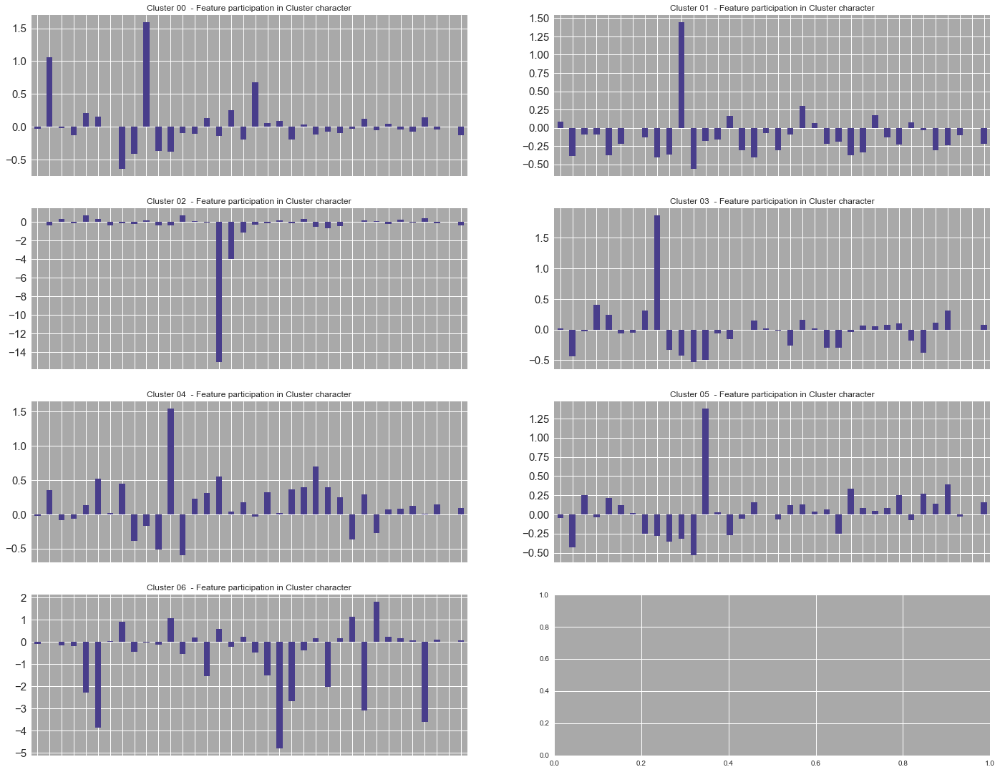

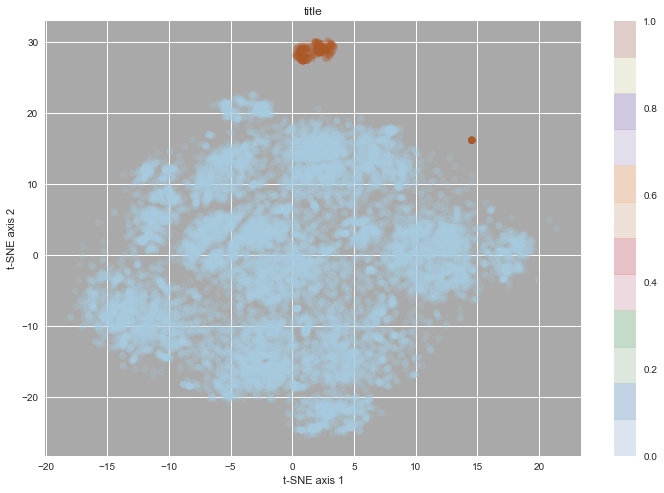

n_clusters =  3


array([0, 0, 0, ..., 1, 0, 0], dtype=int32)

silhouette =  0.3454399438
n_clusters = 3


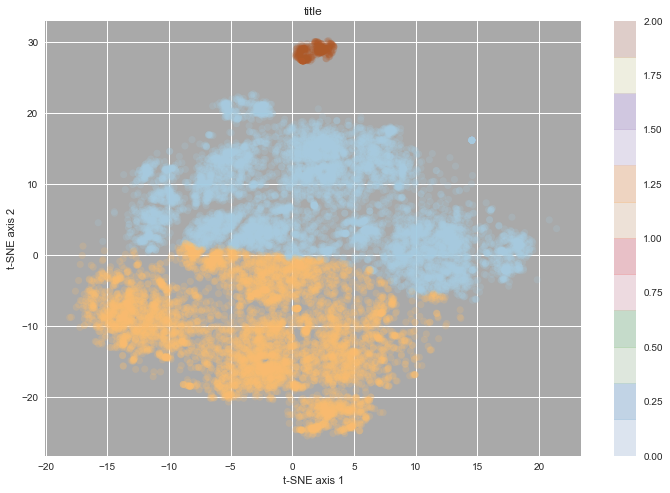

n_clusters =  4


array([1, 1, 1, ..., 0, 1, 1], dtype=int32)

silhouette =  0.271542888381
n_clusters = 4


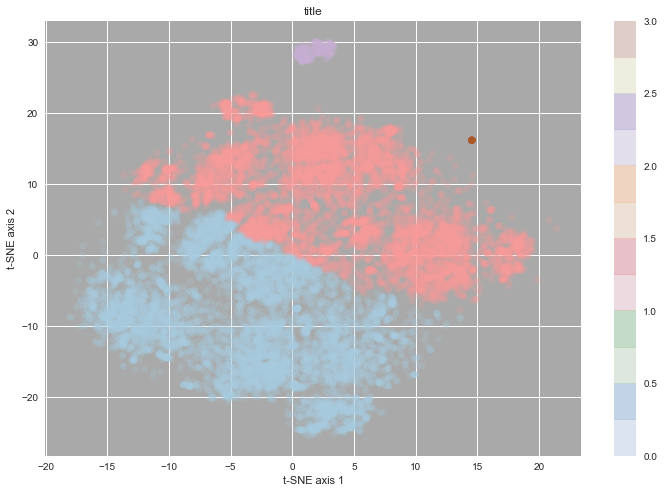

n_clusters =  5


array([4, 4, 0, ..., 1, 0, 0], dtype=int32)

silhouette =  0.35210132905
n_clusters = 5


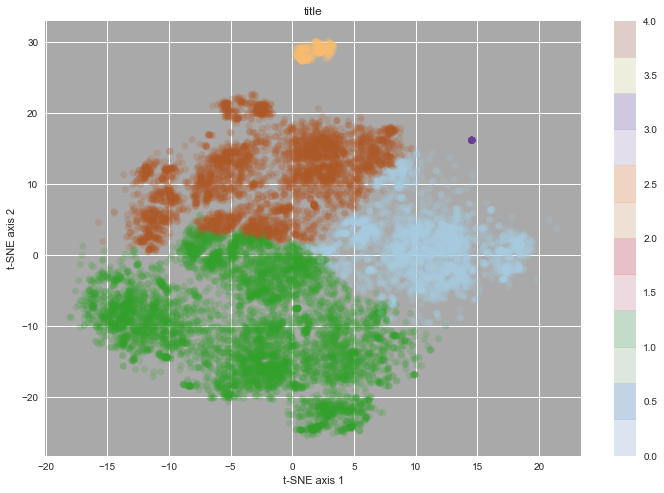

n_clusters =  6


array([0, 1, 4, ..., 1, 4, 4], dtype=int32)

silhouette =  0.38018855792
n_clusters = 6


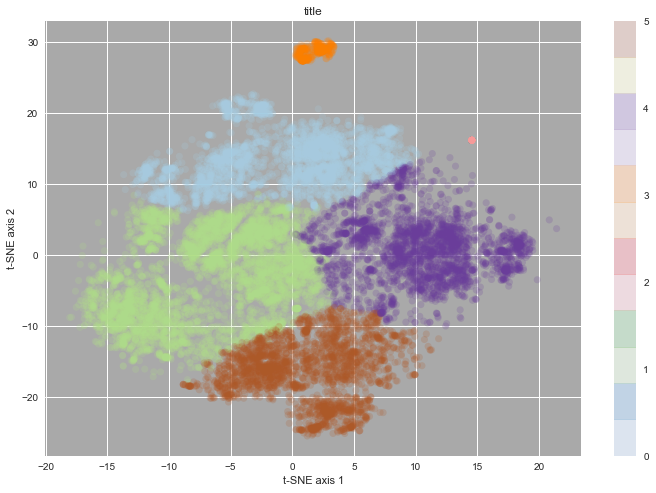

n_clusters =  7


array([3, 6, 1, ..., 6, 1, 1], dtype=int32)

silhouette =  0.406147373957
n_clusters = 7


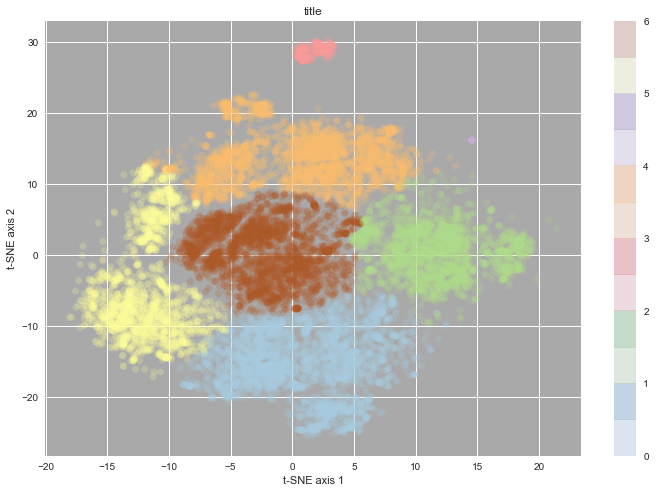

n_clusters =  8


array([1, 2, 3, ..., 2, 3, 3], dtype=int32)

silhouette =  0.420678269335
n_clusters = 8


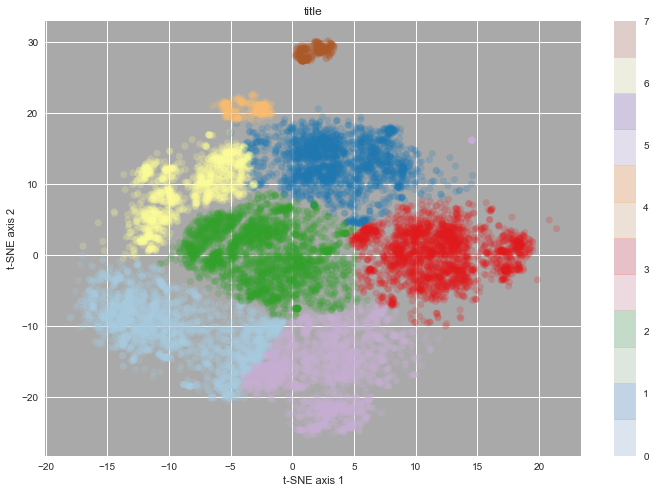

n_clusters =  9


array([2, 3, 6, ..., 3, 6, 6], dtype=int32)

silhouette =  0.41269004953
n_clusters = 9


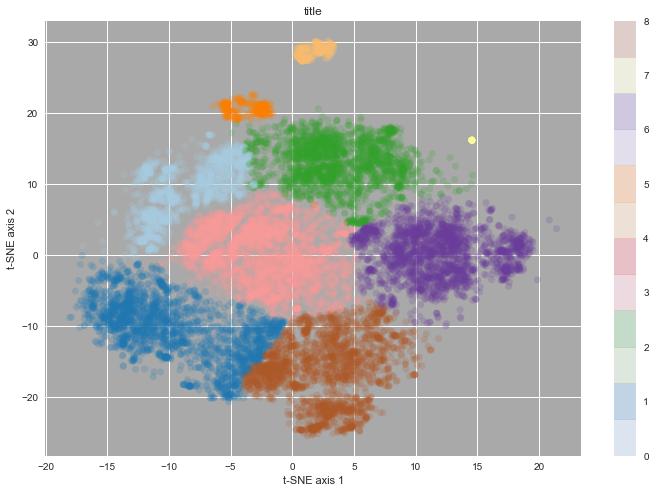

n_clusters =  10


array([1, 0, 7, ..., 0, 7, 7], dtype=int32)

silhouette =  0.411652009985
n_clusters = 10


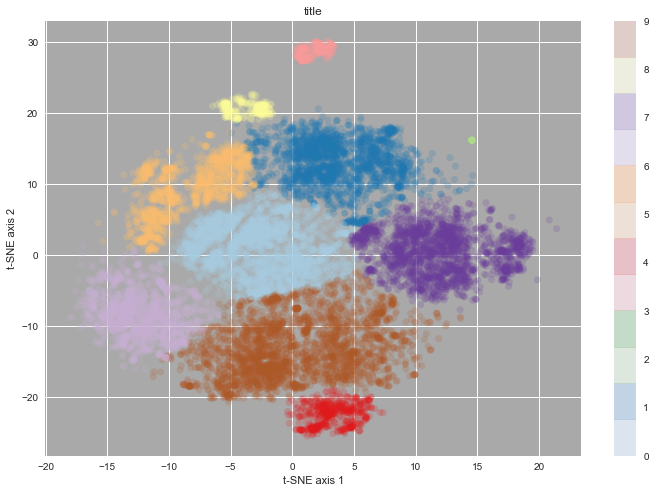

n_clusters =  11


array([ 2,  9,  0, ...,  0,  0, 10], dtype=int32)

silhouette =  0.34505031833
n_clusters = 11


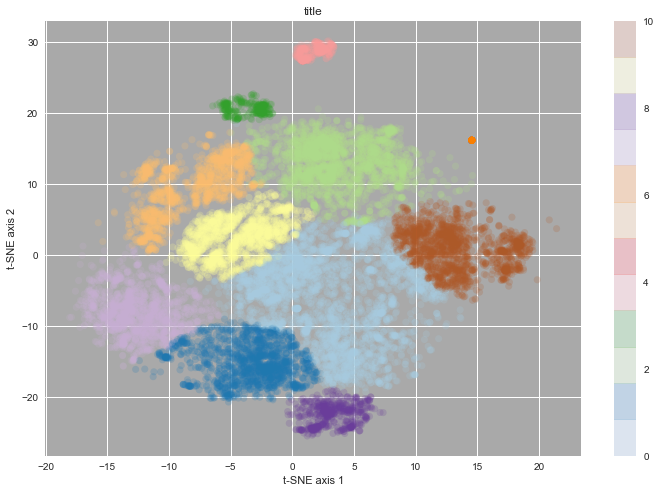

n_clusters =  12


array([ 6, 11,  2, ...,  2,  2, 10], dtype=int32)

silhouette =  0.349519304638
n_clusters = 12


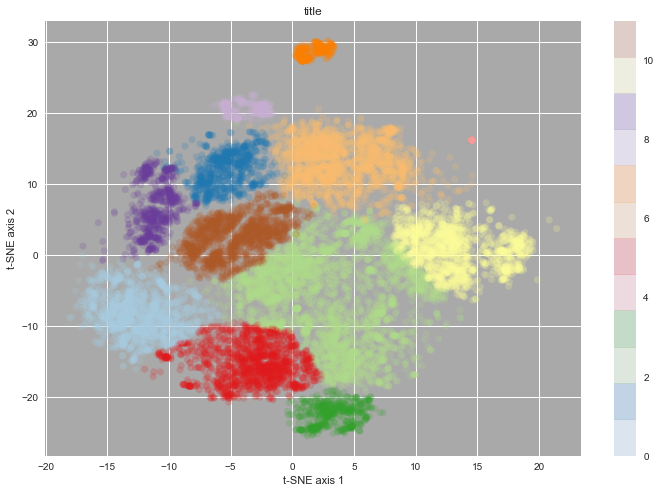

n_clusters =  13


array([5, 1, 0, ..., 1, 0, 0], dtype=int32)

silhouette =  0.384585976011
n_clusters = 13


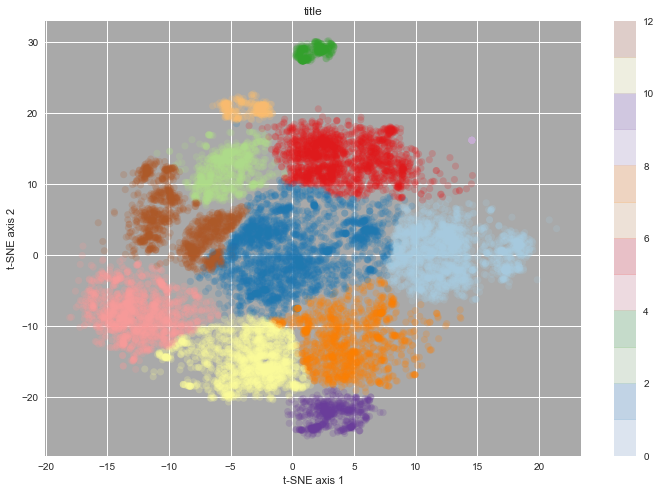

n_clusters =  14


array([6, 2, 3, ..., 2, 3, 3], dtype=int32)

silhouette =  0.365128566935
n_clusters = 14


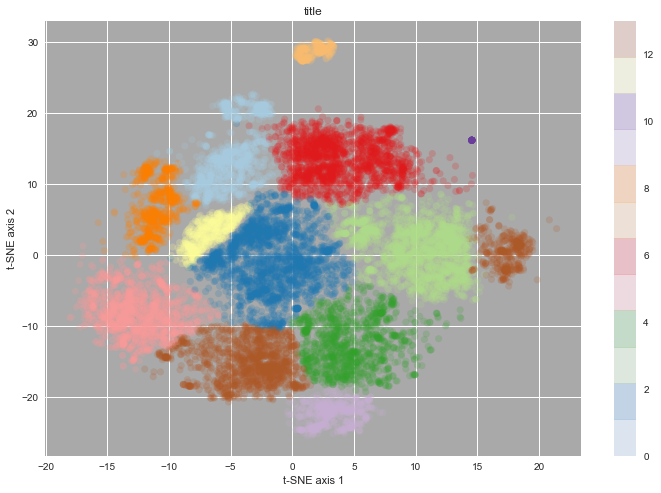

n_clusters =  15


array([ 4,  4,  1, ..., 14,  1,  1], dtype=int32)

silhouette =  0.35528668746
n_clusters = 15


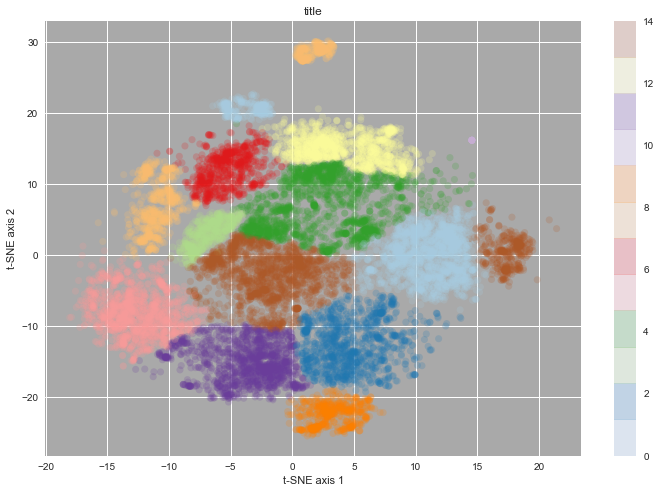

n_clusters =  16


array([ 2, 15,  6, ...,  0,  6,  6], dtype=int32)

silhouette =  0.349624681984
n_clusters = 16


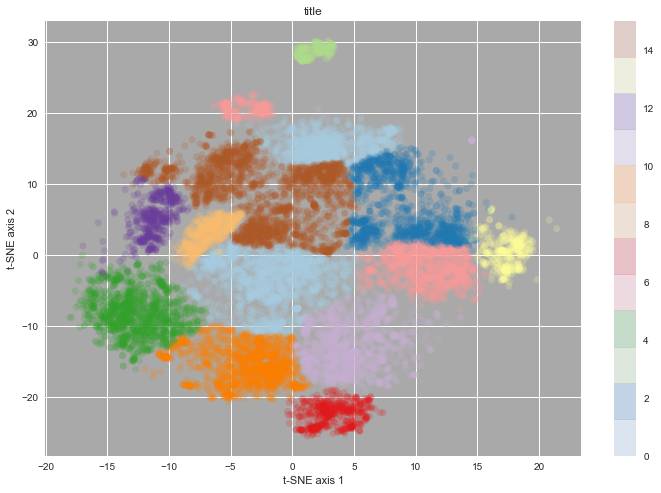

n_clusters =  17


array([16,  1,  8, ...,  4,  8,  8], dtype=int32)

silhouette =  0.346006325128
n_clusters = 17


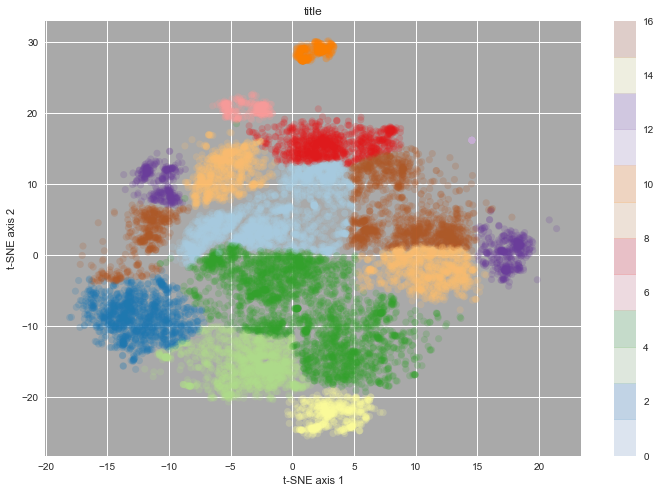

n_clusters =  18


array([14,  6, 12, ...,  1, 12, 12], dtype=int32)

silhouette =  0.354316502394
n_clusters = 18


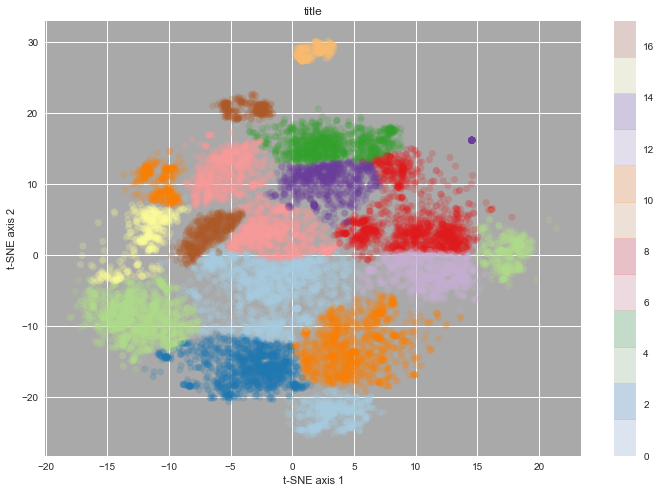

n_clusters =  19


array([16, 14,  9, ...,  6,  1,  9], dtype=int32)

silhouette =  0.378699733295
n_clusters = 19


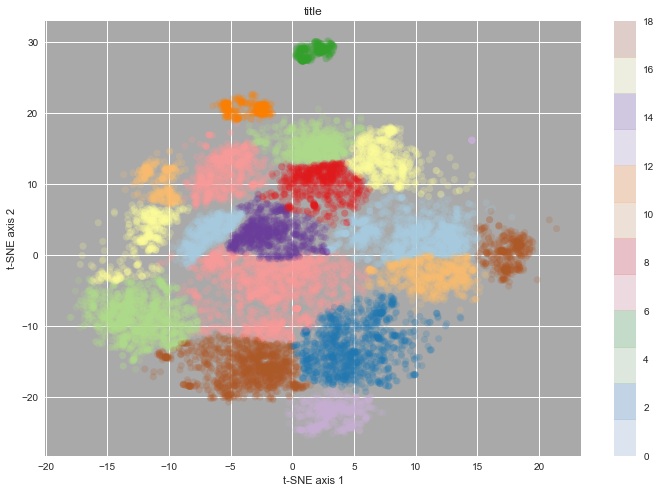

In [69]:
# ... spectraclustering on the t-sne vectors

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = df_join['x-tsne']
X_tsne['t2'] = df_join['y-tsne']


from sklearn.cluster import SpectralClustering

# If a string, this may be one of 
#  ‘nearest_neighbors’, ‘precomputed’, ‘rbf’ 
#  or one of the kernels supported by sklearn.metrics.pairwise_kernels

for n_clstr in range(2, 20):   

    tic = time.clock()
    
    print ("n_clusters = ", n_clstr)

    spc = SpectralClustering(n_clusters = n_clstr,
                             affinity = 'nearest_neighbors')
    spc_labels = spc.fit_predict(X_tsne) 
    spc_labels
    spc_silhouette = metrics.silhouette_score(X_tsne,
                                                 spc_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", spc_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'spc - features',
    'n_clusters' : n_clstr,
    'inertia': 0,
    'silhouette': spc_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    spc_tbl = spc_tbl.append(df_tbl, ignore_index=True)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    _ = plt.figure(figsize=(12, 8));
    _ = plt.subplot(111, facecolor = 'darkgrey');
    
    X_tsne_values = X_tsne.values;
    _ = plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = spc_labels,
                cmap = plt.cm.Paired,
                s = 50,
                linewidths = 0,
                alpha = 0.20);
    _ = plt.colorbar();
    
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    title = print('n_clusters =', n_clstr);
    _ = plt.title('title')
    _ = plt.grid(True);

    _ = plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - 
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-



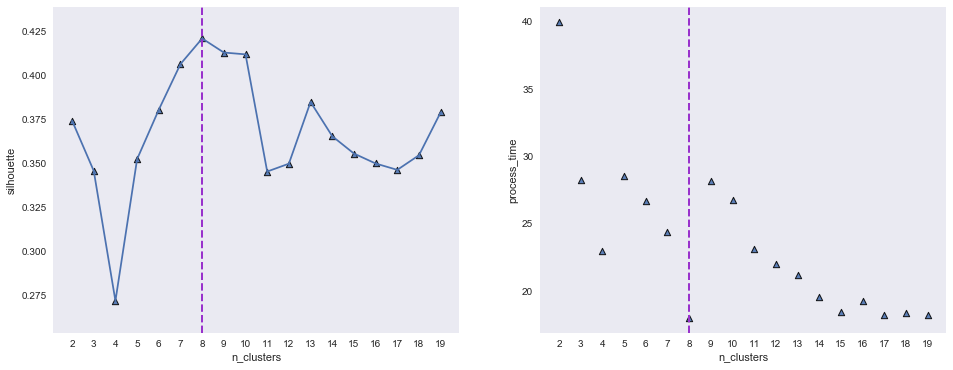

In [70]:
import math

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ...  use max silhouette score to mark optimal number of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

n_optimal_clusters = spc_tbl['silhouette'].argmax() + spc_tbl['n_clusters'].min()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... silhouette values

plt.subplot(121);
plt.scatter(spc_tbl['n_clusters'],
            spc_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(spc_tbl['n_clusters'],
         spc_tbl['silhouette'])

# ... vertical line at max silhouette value

plt.axvline(x = n_optimal_clusters, linewidth = 2, linestyle = 'dashed', color = 'darkorchid')

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
xint = range(min(spc_tbl['n_clusters']), math.ceil(max(spc_tbl['n_clusters']))+1)
plt.xticks(xint)

plt.grid();

# ... process time

plt.subplot(122);
plt.scatter(spc_tbl['n_clusters'],
            spc_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

# ... vertical line at max silhouette value

plt.axvline(x = n_optimal_clusters, linewidth = 2, linestyle = 'dashed', color = 'darkorchid')

plt.xlabel('n_clusters'), plt.ylabel('process_time');
xint = range(min(spc_tbl['n_clusters']), math.ceil(max(spc_tbl['n_clusters']))+1)
plt.xticks(xint)

plt.grid();

plt.savefig("cluster_spctrl_number_of_clusters_eval.png")

plt.show();


### - choose spectral clustering with preferred number of clusters  


In [83]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# max silhouette value occurs at 8, but similar scores across the range from 7 - 10
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

n_clusters_chosen = n_optimal_clusters


for n_clstr in range(n_clusters_chosen, n_clusters_chosen+1):   

    tic = time.clock()
    
    print ("n_clusters = ", n_clstr)

    spc = SpectralClustering(n_clusters = n_clstr,
                             affinity = 'nearest_neighbors')
    spc_labels = spc.fit_predict(X_tsne) 
    spc_labels
    spc_silhouette = metrics.silhouette_score(X_tsne,
                                                 spc_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", spc_silhouette)
    
    toc =  time.clock()



n_clusters =  8


/home/mcdevitt/anaconda3/lib/python3.6/site-packages/sklearn/manifold/spectral_embedding_.py:234: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn("Graph is not fully connected, spectral embedding"


array([6, 1, 2, ..., 1, 2, 2], dtype=int32)

silhouette =  0.400339222187


In [77]:

X_all_together = copy.deepcopy(df_join)

len(X_all_together)

X_all_together['spc_labels'] = spc_labels

X_all_together.describe().T


13875

,count,mean,std,min,25%,50%,75%,max
x-tsne,13875.0,0.057342,7.832323,-18.040400,-5.370572,0.224294,5.271192,21.412487
y-tsne,13875.0,-0.089435,11.888431,-25.457766,-9.427302,0.148256,8.803148,30.184875
sample_index,13875.0,19696.454486,11438.496005,1.000000,9678.500000,19755.000000,29537.000000,39641.000000
n_tokens_title,13875.0,-0.000295,0.999301,-3.499864,-0.661657,-0.188622,0.757447,5.960828
num_keywords,13875.0,-0.007202,1.001735,-3.260042,-0.641015,-0.117210,0.930401,1.454206
data_channel_is_lifestyle,13875.0,0.054198,0.226417,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_entertainment,13875.0,0.178523,0.382966,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_socmed,13875.0,0.057802,0.233377,0.000000,0.000000,0.000000,0.000000,1.000000
kw_avg_max,13875.0,-0.008320,0.995490,-1.913229,-0.649583,-0.112902,0.526353,4.335148
is_weekend,13875.0,0.129658,0.335939,0.000000,0.000000,0.000000,0.000000,1.000000


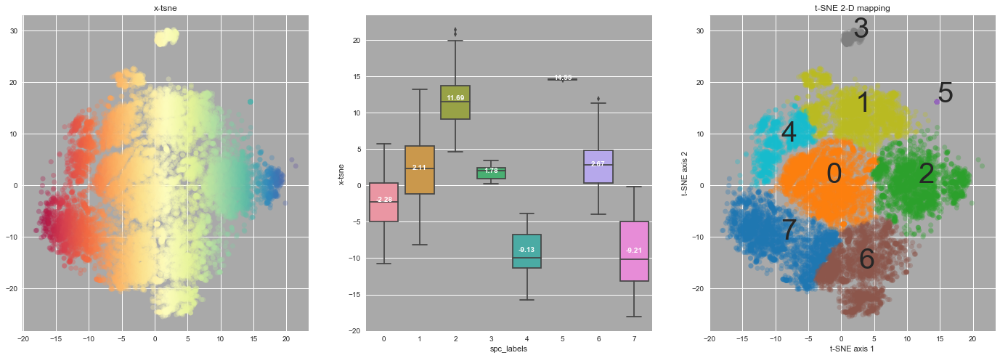

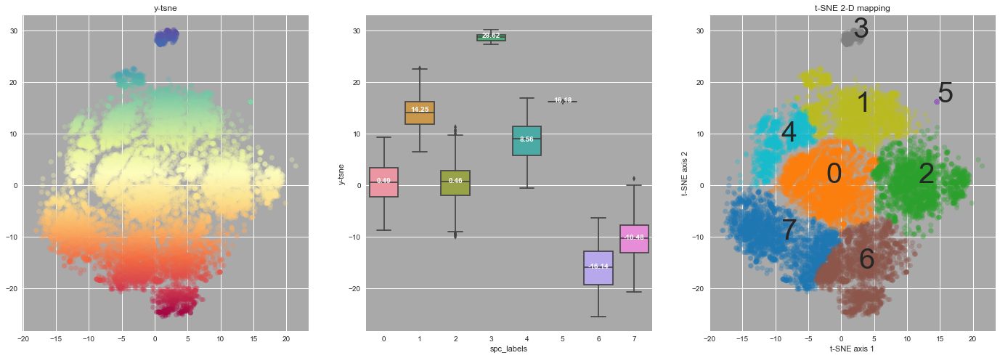

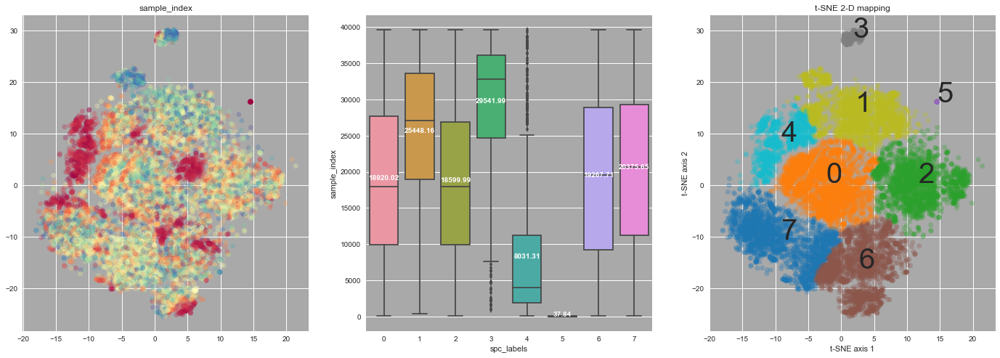

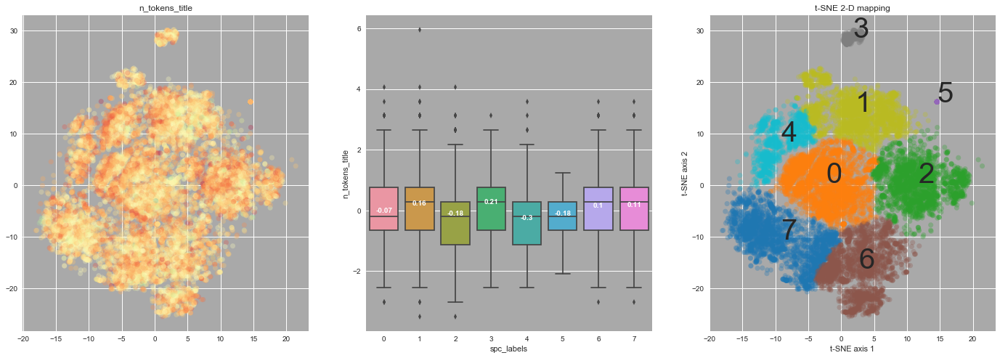

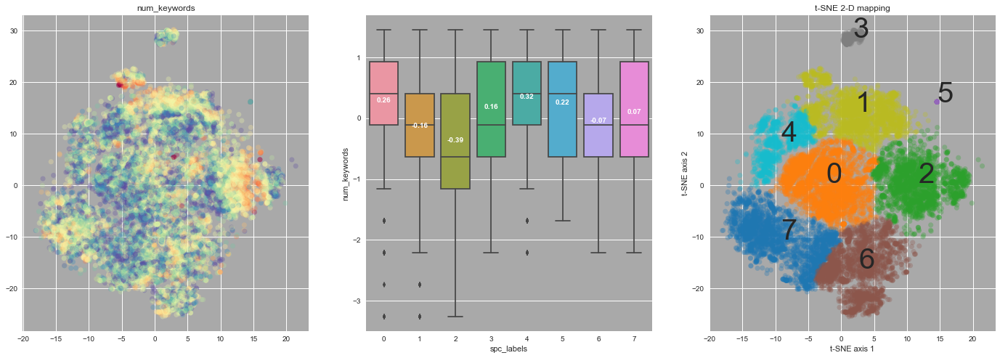

...

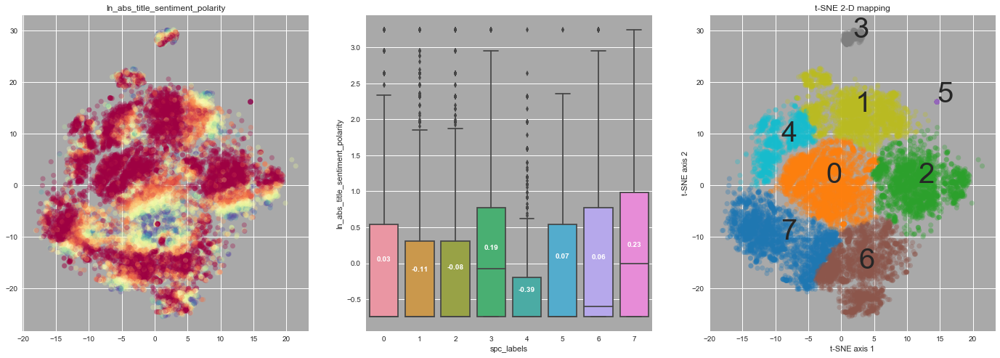

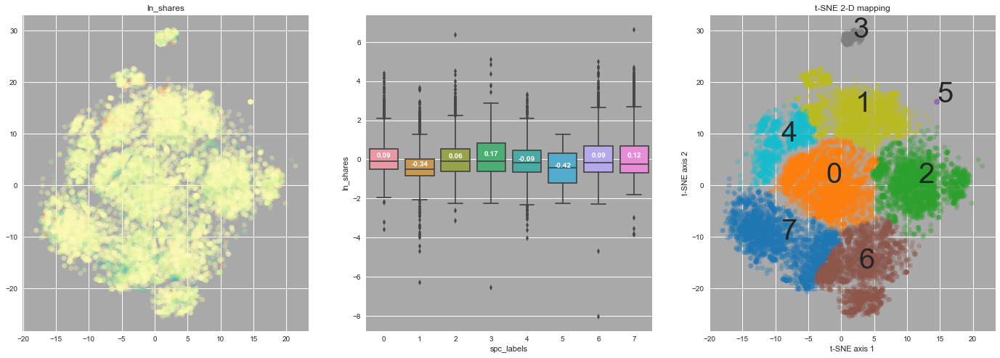

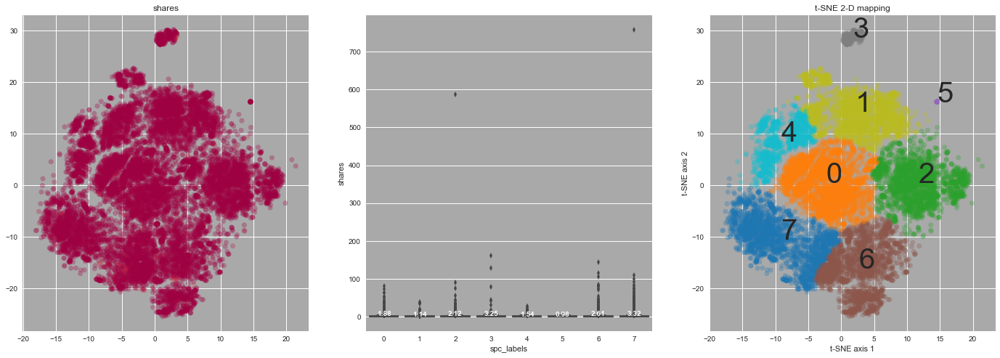

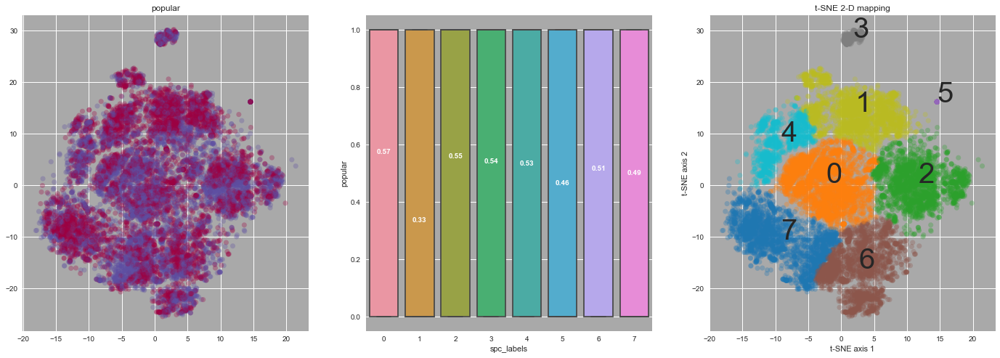

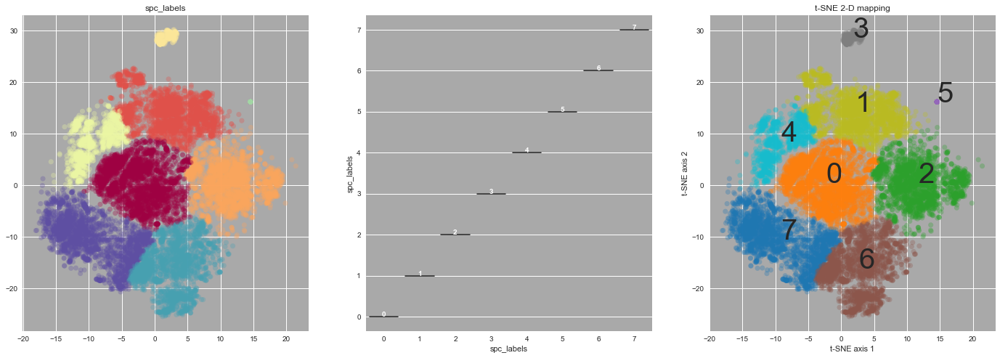

In [84]:
# boxplot across clusters for each feature ...

import seaborn as sns

spc_centers_x = X_all_together.groupby(['spc_labels'])['x-tsne'].mean()
spc_centers_y = X_all_together.groupby(['spc_labels'])['y-tsne'].mean()

col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    
# ... feature distribution color map 

    _ = plt.subplot(131, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132, facecolor = 'darkgrey');
    ax = sns.boxplot(x = "spc_labels", y = col, data = X_all_together);
    
    average_values = X_all_together.groupby(['spc_labels'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):
        
        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')


# ... cluster color map
    
    _ = plt.subplot(133, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = spc_labels,
                 cmap = plt.cm.tab10,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    
    for ii in range(n_clusters_chosen) :                                      
          _ = plt.text(spc_centers_x[ii], spc_centers_y[ii], ii, fontsize = 40)
    
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    
    plt.savefig("cluster_spctrl_3way_preplx_100_%s.png" %col)
 
    plt.show();
    

In [79]:


# ... summary table ... relative difference of each feature within each cluster

X_cluster_analysis = copy.deepcopy(X_all_together)
del X_cluster_analysis['x-tsne']
del X_cluster_analysis['y-tsne']
del X_cluster_analysis['sample_index']

grouped = X_cluster_analysis.groupby(['spc_labels'])

cluster_analysis_tbl = (grouped.mean() - X_cluster_analysis.mean()) / X_cluster_analysis.std()

cluster_analysis_tbl



,abs_title_subjectivity,data_channel_is_entertainment,data_channel_is_lifestyle,data_channel_is_socmed,global_rate_positive_words,global_subjectivity,is_weekend,kw_avg_max,ln_LDA_00,ln_LDA_01,...,max_negative_polarity,max_positive_polarity,min_negative_polarity,n_tokens_title,num_keywords,popular,rate_positive_words,shares,spc_labels,title_sentiment_polarity
spc_labels,,,,,,,,,,,,,,,,,,,,,
0,-0.037425,-0.419692,0.252220,-0.056305,0.211851,0.129138,0.011842,-0.258066,-0.284702,-0.347403,...,0.040159,0.089716,0.254335,-0.071191,0.265844,0.145208,0.389518,-0.028195,NaN,0.170884
1,0.047433,-0.381555,-0.181074,-0.086563,-0.462968,-0.273568,0.023642,-0.027838,-0.396390,-0.368962,...,0.162640,-0.182121,-0.237527,0.159370,-0.148512,-0.333967,-0.281260,-0.103355,NaN,-0.191319
2,0.015299,-0.432421,-0.032047,0.411116,0.245510,-0.055708,-0.048798,0.327152,1.881809,-0.324411,...,0.004416,0.071783,0.098226,-0.176024,-0.384328,0.113514,0.317781,-0.004109,NaN,0.054252
3,-0.082404,0.006789,-0.149238,-0.182091,-2.295207,-3.851334,0.039291,0.898130,-0.444409,-0.025655,...,1.129868,-3.081914,1.800087,0.211245,0.164970,0.079861,-3.615874,0.110891,NaN,0.080641
4,0.301354,-0.411568,0.403116,-0.072248,0.085231,0.017508,-0.121473,-1.085090,-0.390995,-0.314559,...,0.084553,0.043631,0.059770,-0.303914,0.331548,0.060697,0.165655,-0.062322,NaN,-0.207561
5,0.059130,-0.325012,0.357469,-0.131867,0.688717,0.302375,-0.385957,-0.105055,-0.161954,0.197554,...,0.056571,0.157575,0.115517,-0.175666,0.229359,-0.072649,0.412561,-0.119212,NaN,-0.320110
6,0.044155,0.456746,-0.138727,-0.033239,0.165299,0.484913,-0.005552,0.489183,-0.401590,-0.237797,...,-0.419991,0.263991,-0.208759,0.096025,-0.064491,0.028986,0.059156,0.045809,NaN,0.063312
7,-0.194564,1.104745,-0.127654,-0.144708,0.163000,0.352600,0.072099,-0.062278,-0.436260,1.503961,...,-0.056525,0.249948,-0.284362,0.114678,0.081088,-0.003372,-0.030143,0.117496,NaN,-0.025551


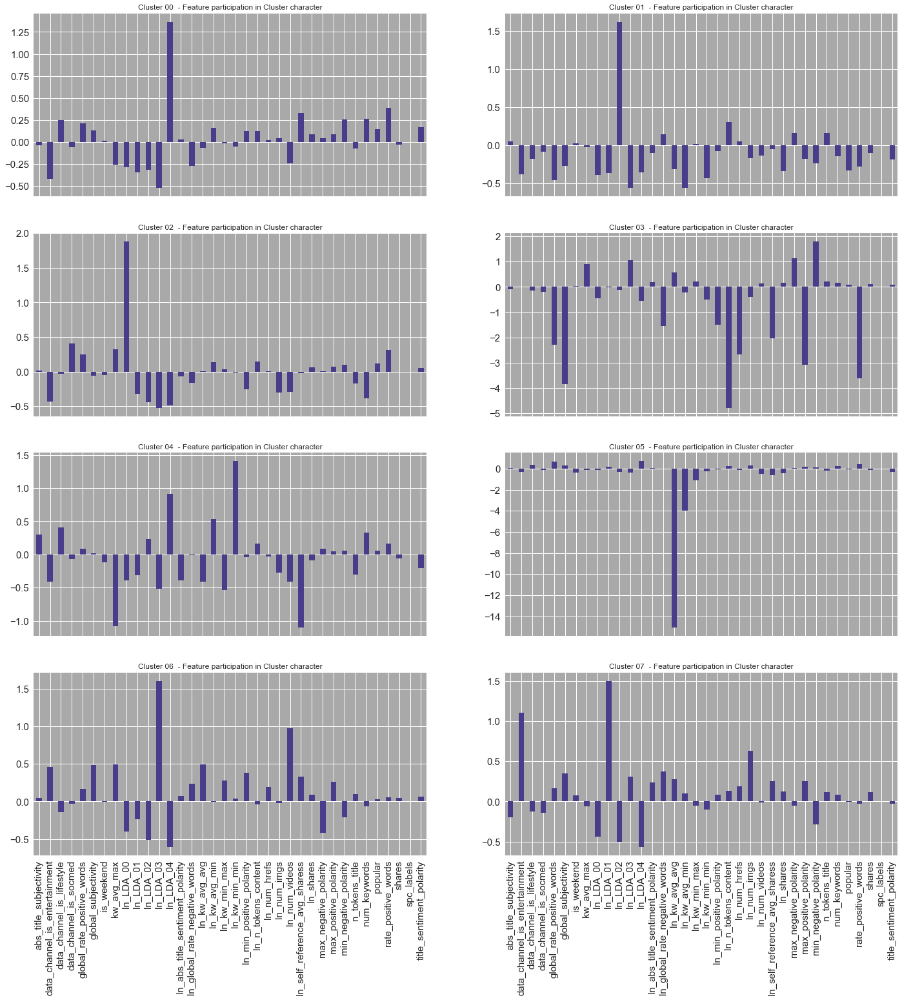

In [80]:


_ = plt.figure(figsize=(24, 24));
    
# .sort_values(ascending = False)

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    if ii < n_optimal_clusters-1 :
        wgt = pd.Series(cluster_analysis_tbl.ix[ii])
    else :
        wgt = pd.Series(cluster_analysis_tbl.ix[ii],
                    index = cluster_analysis_tbl.columns)
        
    _ = wgt.plot(kind = 'bar', fontsize = 15, color = 'darkslateblue')
    
    _ = plt.grid(True)    
    if ii < n_optimal_clusters-2:
        _ = ax.xaxis.set_ticklabels([])
    
    _ = plt.title("Cluster %02d  - Feature participation in Cluster character" %ii)
    
plt.savefig("cluster_spctrl_cluster_barplots_vertical.png")

plt.show()

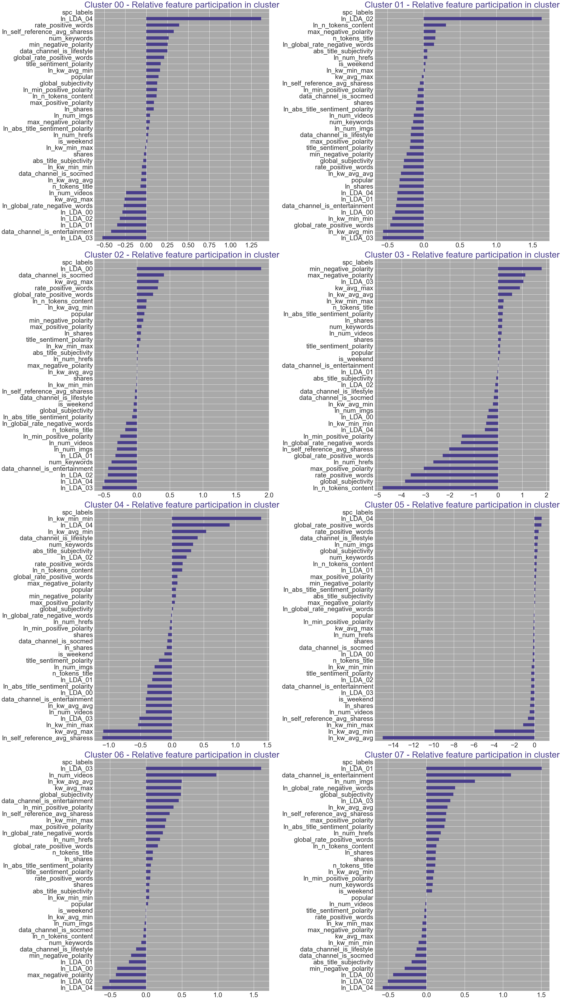

In [81]:

_ = plt.figure(figsize=(36, 64));
    

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    wgt = pd.Series(cluster_analysis_tbl.ix[ii],
                    index = cluster_analysis_tbl.columns).sort_values(ascending = True)
        
    _ = wgt.plot(kind = 'barh', fontsize = 30, color = 'darkslateblue')
    
    _ = plt.title("Cluster %02d - Relative feature participation in cluster" %ii,
                  fontsize = 40,
                 color = 'darkslateblue')
    
    _ = plt.tight_layout()
    
plt.savefig("cluster_spctrl_cluster_barplots_horizontal.png")

plt.show()

In [82]:
cluster_analysis_tbl.T

spc_labels,0,1,2,3,4,5,6,7
abs_title_subjectivity,-0.037425,0.047433,0.015299,-0.082404,0.301354,0.059130,0.044155,-0.194564
data_channel_is_entertainment,-0.419692,-0.381555,-0.432421,0.006789,-0.411568,-0.325012,0.456746,1.104745
data_channel_is_lifestyle,0.252220,-0.181074,-0.032047,-0.149238,0.403116,0.357469,-0.138727,-0.127654
data_channel_is_socmed,-0.056305,-0.086563,0.411116,-0.182091,-0.072248,-0.131867,-0.033239,-0.144708
global_rate_positive_words,0.211851,-0.462968,0.245510,-2.295207,0.085231,0.688717,0.165299,0.163000
global_subjectivity,0.129138,-0.273568,-0.055708,-3.851334,0.017508,0.302375,0.484913,0.352600
is_weekend,0.011842,0.023642,-0.048798,0.039291,-0.121473,-0.385957,-0.005552,0.072099
kw_avg_max,-0.258066,-0.027838,0.327152,0.898130,-1.085090,-0.105055,0.489183,-0.062278
ln_LDA_00,-0.284702,-0.396390,1.881809,-0.444409,-0.390995,-0.161954,-0.401590,-0.436260
ln_LDA_01,-0.347403,-0.368962,-0.324411,-0.025655,-0.314559,0.197554,-0.237797,1.503961


In [95]:
col_names = X_all_together.columns.values.tolist()

n_plt_cols = 3
plot_rows = int((len(col_names) + 1) / n_plt_cols)
i_plt = 0
i_plt+=1

plot_rows
len(col_names)
n_plt_cols
i_plt

X_all_together.head()
col_names


13

39

3

1

,x-tsne,y-tsne,sample_index,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,...,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular,spc_labels
0,6.372708,10.256525,25262,-0.661657,-0.641015,0,0,0,0.204035,0,...,2.177684,-0.666499,-0.723097,0.863376,0.100486,0.275620,1.917598,6.804593,1,1
1,-1.809862,5.370107,28135,1.230482,1.454206,0,0,0,-0.234979,0,...,0.511467,-0.726616,1.391734,0.799234,0.100486,-0.740381,0.331411,1.392932,1,0
2,9.933781,-4.613188,35014,0.284413,1.454206,0,0,0,-0.055565,0,...,-0.285926,-0.724789,0.428270,-0.125650,0.100486,1.195125,0.237898,1.268579,1,2
3,2.773935,0.517896,14875,0.757447,1.454206,0,0,0,-0.822032,0,...,-0.274876,-0.726522,1.937072,-1.553284,-0.475120,-0.062851,-1.080744,0.339343,0,0
4,1.925458,-24.505457,15743,0.757447,-1.688626,0,0,0,2.930478,0,...,-0.597486,1.899937,-0.647785,3.094667,0.100486,1.311338,-1.301977,0.271993,0,6


['x-tsne',
 'y-tsne',
 'sample_index',
 'n_tokens_title',
 'num_keywords',
 'data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_socmed',
 'kw_avg_max',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares',
 'shares',
 'popular',
 'spc_labels']

In [103]:

# .... all features maps in one big plot
   
col_names = X_all_together.columns.values.tolist()

n_plt_cols = 3
plot_rows = int((len(col_names) + 1) / n_plt_cols)
i_plt = 0

_ = plt.figure(figsize=(24, 96));

for col in col_names :
    
    i_plt += 1
    ax = plt.subplot(plot_rows, n_plt_cols, i_plt, facecolor = 'darkgrey');

# ... feature distribution color map 
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
#    _ = plt.title(col)
    
    _ = plt.grid(False)
    _ = ax.xaxis.set_ticklabels([])
    _ = ax.yaxis.set_ticklabels([])
    _ = plt.tight_layout()
    
plt.savefig("cluster_feature_maps.png")

#plt.show()

<a href='#toc'> Table of Contents</a>

<a name='end_of_file'></a>
<font color="blue" size=3>  end of file